# ---提出问题---

1. 哪种名字比较受欢迎？
2. 不同种类狗起名字的偏好是什么？
3. 高点赞代表高转发吗？
4. 高点赞代表了专业好评吗？

# ---清洗数据---

In [2]:
#下载twitter-archive-enhanced.csv数据
# download url link: https://raw.githubusercontent.com/udacity/new-dand-advanced-china/master/%E6%95%B0%E6%8D%AE%E6%B8%85%E6%B4%97/WeRateDogs%E9%A1%B9%E7%9B%AE/twitter-archive-enhanced.csv
import requests
import pandas as pd
import numpy as np
import io
import re
# 设置pandas显示参数，方便浏览全部信息
pd.set_option('display.max_colwidth', -1)
pd.options.display.max_rows = 999
url_weratedogs = 'https://raw.githubusercontent.com/udacity/new-dand-advanced-china/master/%E6%95%B0%E6%8D%AE%E6%B8%85%E6%B4%97/WeRateDogs%E9%A1%B9%E7%9B%AE/twitter-archive-enhanced.csv'
url_image_predicted = 'https://raw.githubusercontent.com/udacity/new-dand-advanced-china/master/%E6%95%B0%E6%8D%AE%E6%B8%85%E6%B4%97/WeRateDogs%E9%A1%B9%E7%9B%AE/image-predictions.tsv'
url_tweet_json = 'https://raw.githubusercontent.com/udacity/new-dand-advanced-china/master/%E6%95%B0%E6%8D%AE%E6%B8%85%E6%B4%97/WeRateDogs%E9%A1%B9%E7%9B%AE/tweet_json.txt'

# 从网页链接中提取信息
response_weratedogs = requests.get(url_weratedogs).content
response_image = requests.get(url_image_predicted).content
response_tweet_json = requests.get(url_tweet_json).content

#存储提取出的信息至csv，tsv和json文件中
file_weratedogs = url_weratedogs.split('/')[-1]
file_image_predicted = url_image_predicted.split('/')[-1]
file_tweet_json = url_tweet_json.split('/')[-1]

with open(file_weratedogs,mode = 'wb') as f:
    f.write(response_weratedogs)
with open(file_image_predicted,mode ='wb') as f:
    f.write(response_image)
with open(file_tweet_json,mode ='wb') as f:
    f.write(response_tweet_json)


# 读取文件至dataframe中
df_weratedogs = pd.read_csv(file_weratedogs)
df_predicted_image = pd.read_csv(file_image_predicted,sep="\t")
df_tweet_json = pd.read_json(file_tweet_json,lines= True)


In [3]:
# 视觉评估
df_weratedogs

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
0,892420643555336193,NaN,NaN,2017-08-01 16:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13,10,Phineas,None,None,None,None
1,892177421306343426,NaN,NaN,2017-08-01 00:17:27 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",NaN,NaN,NaN,https://twitter.com/dog_rates/status/892177421306343426/photo/1,13,10,Tilly,None,None,None,None
2,891815181378084864,NaN,NaN,2017-07-31 00:18:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12,10,Archie,None,None,None,None
3,891689557279858688,NaN,NaN,2017-07-30 15:58:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13,10,Darla,None,None,None,None
4,891327558926688256,NaN,NaN,2017-07-29 16:00:24 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f",NaN,NaN,NaN,"https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12,10,Franklin,None,None,None,None
5,891087950875897856,NaN,NaN,2017-07-29 00:08:17 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here we have a majestic great white breaching off South Africa's coast. Absolutely h*ckin breathtaking. 13/10 (IG: tucker_marlo) #BarkWeek https://t.co/kQ04fDDRmh,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891087950875897856/photo/1,13,10,None,None,None,None,None
6,890971913173991426,NaN,NaN,2017-07-28 16:27:12 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Jax. He enjoys ice cream so much he gets nervous around it. 13/10 help Jax enjoy more things by clicking below\n\nhttps://t.co/Zr4hWfAs1H https://t.co/tVJBRMnhxl,NaN,NaN,NaN,"https://gofundme.com/ydvmve-surgery-for-jax,https://twitter.com/dog_rates/status/890971913173991426/photo/1",13,10,Jax,None,None,None,None
7,890729181411237888,NaN,NaN,2017-07-28 00:22:40 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",When you watch your owner call another dog a good boy but then they turn back to you and say you're a great boy. 13/10 https://t.co/v0nONBcwxq,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/890729181411237888/photo/1,https://twitter.com/dog_rates/status/890729181411237888/photo/1",13,10,None,None,None,None,None
8,890609185150312448,NaN,NaN,2017-07-27 16:25:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Zoey. She doesn't want to be one of the scary sharks. Just wants to be a snuggly pettable boatpet. 13/10 #BarkWeek https://t.co/9TwLuAGH0b,NaN,NaN,NaN,https://twitter.com/dog_rates/status/890609185150312448/photo/1,13,10,Zoey,None,None,None,None
9,89024025534

In [4]:
# 程序评估
df_weratedogs.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
tweet_id                      2356 non-null int64
in_reply_to_status_id         78 non-null float64
in_reply_to_user_id           78 non-null float64
timestamp                     2356 non-null object
source                        2356 non-null object
text                          2356 non-null object
retweeted_status_id           181 non-null float64
retweeted_status_user_id      181 non-null float64
retweeted_status_timestamp    181 non-null object
expanded_urls                 2297 non-null object
rating_numerator              2356 non-null int64
rating_denominator            2356 non-null int64
name                          2356 non-null object
doggo                         2356 non-null object
floofer                       2356 non-null object
pupper                        2356 non-null object
puppo                         2356 non-null object
dtypes: float64(4), int64(3), ob

In [5]:
# 查看来source布情况
df_weratedogs.source.value_counts()

<a href="http://twitter.com/download/iphone" rel="nofollow">Twitter for iPhone</a>     2221
<a href="http://vine.co" rel="nofollow">Vine - Make a Scene</a>                        91  
<a href="http://twitter.com" rel="nofollow">Twitter Web Client</a>                     33  
<a href="https://about.twitter.com/products/tweetdeck" rel="nofollow">TweetDeck</a>    11  
Name: source, dtype: int64

In [6]:
# 查看expanded_urls分布情况
df_weratedogs.expanded_urls

0       https://twitter.com/dog_rates/status/892420643555336193/photo/1                                                                                                                                                                                                                                                                                                                                                                                                                                                                
1       https://twitter.com/dog_rates/status/892177421306343426/photo/1                                                                                                                                                                                                                                                                                                                                                                                                                         

In [7]:
# 浏览text中的具体内容
df_weratedogs.text

0       This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU                                                            
1       This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV       
2       This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB                        
3       This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ                                                                  
4       This is Franklin. He would like you to stop calling him "cute." He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f       
5       Here we have a majestic great white breaching off South Africa's coast. Absolutely h*ckin breathtaking

In [8]:
#视觉评估
df_predicted_image

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,666020888022790149,https://pbs.twimg.com/media/CT4udn0WwAA0aMy.jpg,1,Welsh_springer_spaniel,0.465074,True,collie,1.566650e-01,True,Shetland_sheepdog,6.142850e-02,True
1,666029285002620928,https://pbs.twimg.com/media/CT42GRgUYAA5iDo.jpg,1,redbone,0.506826,True,miniature_pinscher,7.419170e-02,True,Rhodesian_ridgeback,7.201000e-02,True
2,666033412701032449,https://pbs.twimg.com/media/CT4521TWwAEvMyu.jpg,1,German_shepherd,0.596461,True,malinois,1.385840e-01,True,bloodhound,1.161970e-01,True
3,666044226329800704,https://pbs.twimg.com/media/CT5Dr8HUEAA-lEu.jpg,1,Rhodesian_ridgeback,0.408143,True,redbone,3.606870e-01,True,miniature_pinscher,2.227520e-01,True
4,666049248165822465,https://pbs.twimg.com/media/CT5IQmsXIAAKY4A.jpg,1,miniature_pinscher,0.560311,True,Rottweiler,2.436820e-01,True,Doberman,1.546290e-01,True
5,666050758794694657,https://pbs.twimg.com/media/CT5Jof1WUAEuVxN.jpg,1,Bernese_mountain_dog,0.651137,True,English_springer,2.637880e-01,True,Greater_Swiss_Mountain_dog,1.619920e-02,True
6,666051853826850816,https://pbs.twimg.com/media/CT5KoJ1WoAAJash.jpg,1,box_turtle,0.933012,False,mud_turtle,4.588540e-02,False,terrapin,1.788530e-02,False
7,666055525042405380,https://pbs.twimg.com/media/CT5N9tpXIAAifs1.jpg,1,chow,0.692517,True,Tibetan_mastiff,5.827940e-02,True,fur_coat,5.444860e-02,False
8,666057090499244032,https://pbs.twimg.com/media/CT5PY90WoAAQGLo.jpg,1,shopping_cart,0.962465,False,shopping_basket,1.459380e-02,False,golden_retriever,7.958960e-03,True
9,666058600524156928,https://pbs.twimg.com/media/CT5Qw94XAAA_2dP.jpg,1,miniature_poodle,0.201493,True,komondor,1.923050e-01,True,soft-coated_wheaten_terrier,8.208610e-02,True


In [9]:
# 程序评估
df_predicted_image.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
tweet_id    2075 non-null int64
jpg_url     2075 non-null object
img_num     2075 non-null int64
p1          2075 non-null object
p1_conf     2075 non-null float64
p1_dog      2075 non-null bool
p2          2075 non-null object
p2_conf     2075 non-null float64
p2_dog      2075 non-null bool
p3          2075 non-null object
p3_conf     2075 non-null float64
p3_dog      2075 non-null bool
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


In [10]:
# 查看jpg_url分布情况
df_predicted_image.jpg_url.value_counts()

https://pbs.twimg.com/media/CWza7kpWcAAdYLc.jpg                                            2
https://pbs.twimg.com/media/CtKHLuCWYAA2TTs.jpg                                            2
https://pbs.twimg.com/ext_tw_video_thumb/815965888126062592/pu/img/JleSw4wRhgKDWQj5.jpg    2
https://pbs.twimg.com/media/CxqsX-8XUAAEvjD.jpg                                            2
https://pbs.twimg.com/media/Cbs3DOAXIAAp3Bd.jpg                                            2
https://pbs.twimg.com/media/CkjMx99UoAM2B1a.jpg                                            2
https://pbs.twimg.com/media/Crwxb5yWgAAX5P_.jpg                                            2
https://pbs.twimg.com/media/Ct2qO5PXEAE6eB0.jpg                                            2
https://pbs.twimg.com/media/CsrjryzWgAAZY00.jpg                                            2
https://pbs.twimg.com/media/CtzKC7zXEAALfSo.jpg                                            2
https://pbs.twimg.com/media/CeRoBaxWEAABi0X.jpg                       

In [11]:
# 统计个数
sum(df_predicted_image.jpg_url.value_counts()==2)

66

In [12]:
# 视觉评估
df_tweet_json

,contributors,coordinates,created_at,display_text_range,entities,extended_entities,favorite_count,favorited,full_text,geo,...,possibly_sensitive_appealable,quoted_status,quoted_status_id,quoted_status_id_str,retweet_count,retweeted,retweeted_status,source,truncated,user
0,NaN,NaN,2017-08-01 16:23:56,"[0, 85]","{'hashtags': [], 'symbols': [], 'user_mentions': [], 'urls': [], 'media': [{'id': 892420639486877696, 'id_str': '892420639486877696', 'indices': [86, 109], 'media_url': 'http://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg', 'media_url_https': 'https://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg', 'url': 'https://t.co/MgUWQ76dJU', 'display_url': 'pic.twitter.com/MgUWQ76dJU', 'expanded_url': 'https://twitter.com/dog_rates/status/892420643555336193/photo/1', 'type': 'photo', 'sizes': {'large': {'w': 540, 'h': 528, 'resize': 'fit'}, 'thumb': {'w': 150, 'h': 150, 'resize': 'crop'}, 'small': {'w': 540, 'h': 528, 'resize': 'fit'}, 'medium': {'w': 540, 'h': 528, 'resize': 'fit'}}}]}","{'media': [{'id': 892420639486877696, 'id_str': '892420639486877696', 'indices': [86, 109], 'media_url': 'http://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg', 'media_url_https': 'https://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg', 'url': 'https://t.co/MgUWQ76dJU', 'display_url': 'pic.twitter.com/MgUWQ76dJU', 'expanded_url': 'https://twitter.com/dog_rates/status/892420643555336193/photo/1', 'type': 'photo', 'sizes': {'large': {'w': 540, 'h': 528, 'resize': 'fit'}, 'thumb': {'w': 150, 'h': 150, 'resize': 'crop'}, 'small': {'w': 540, 'h': 528, 'resize': 'fit'}, 'medium': {'w': 540, 'h': 528, 'resize': 'fit'}}}]}",39492,False,This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,NaN,...,0.0,NaN,NaN,NaN,8842,False,NaN,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",False,"{'id': 4196983835, 'id_str': '4196983835', 'name': 'SpookyWeRateDogs™', 'screen_name': 'dog_rates', 'location': 'MERCH↴ DM DOGS. WE WILL RATE', 'description': 'Only Legit Source for Professional Dog Ratings STORE: @ShopWeRateDogs | IG, FB & SC: WeRateDogs | MOBILE APP: @GoodDogsGame Business: dogratingtwitter@gmail.com', 'url': 'https://t.co/N7sNNHAEXS', 'entities': {'url': {'urls': [{'url': 'https://t.co/N7sNNHAEXS', 'expanded_url': 'http://weratedogs.com', 'display_url': 'weratedogs.com', 'indices': [0, 23]}]}, 'description': {'urls': []}}, 'protected': False, 'followers_count': 3768791, 'friends_count': 107, 'listed_count': 3169, 'created_at': 'Sun Nov 15 21:41:29 +0000 2015', 'favourites_count': 120162, 'utc_offset': None, 'time_zone': None, 'geo_enabled': True, 'verified': True, 'statuses_count': 5749, 'lang': 'en', 'contributors_enabled': False, 'is_translator': False, 'is_translation_enabled': False, 'profile_background_color': '000000', 'profile_background_image_url': 'http://abs.twimg.com/images/themes/theme1/bg.png', 'profile_background_image_url_https': 'https://abs.twimg.com/images/themes/theme1/bg.png', 'profile_background_tile': False, 'profile_image_url': 'http://pbs.twimg.com/profile_images/914581071265755136/2h5uFpwU_normal.jpg', 'profile_image_url_https': 'https://pbs.twimg.com/profile_images/914581071265755136/2h5uFpwU_normal.jpg', 'profile_banner_url': 'https://pbs.twimg.com/profile_banners/4196983835/1506888628', 'profile_link_color': 'F5ABB5', 'profile_sidebar_border_color': '000000', 'profile_sidebar_fill_color': '000000', 'profile_text_color': '000000', 'profile_use_background_image': False, 'has_extended_profile': True, 'default_profile': False, 'default_profile_image': False, 'following': False, 'follow_request_sent': False, 'notifications': False, 'translator_type': 'none'}"
1,NaN,NaN,2017-08-01 00:17:27,"[0, 138]","{'hashtags': [], 'symbols': [], 'user_mentions': [], 'urls': [], 'media': [{'id': 892177413194625024, 'id_str': '892177413194625024', 'indices': [139, 162], 'media_url': 'http://pbs.twimg.com/media/DGGmoV4XsAAUL6n.jpg', 'media_url_https': 'https://pbs.twimg.com/media

In [13]:
# 程序评估
df_tweet_json.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2352 entries, 0 to 2351
Data columns (total 31 columns):
contributors                     0 non-null float64
coordinates                      0 non-null float64
created_at                       2352 non-null datetime64[ns]
display_text_range               2352 non-null object
entities                         2352 non-null object
extended_entities                2073 non-null object
favorite_count                   2352 non-null int64
favorited                        2352 non-null bool
full_text                        2352 non-null object
geo                              0 non-null float64
id                               2352 non-null int64
id_str                           2352 non-null int64
in_reply_to_screen_name          78 non-null object
in_reply_to_status_id            78 non-null float64
in_reply_to_status_id_str        78 non-null float64
in_reply_to_user_id              78 non-null float64
in_reply_to_user_id_str          78 n

# Access


## 质量

### weratedogs table:
1. expanded_urls缺少数据  （完整性）
2. expanded_urls重复数据（唯一性）
3. in_reply_to_status_id和in_reply_to_user_id大量缺少数据 （完整性）
4. 一些狗的名字显示为a,an,the等英文冠词 （有效性） 
6. rating_numerator和rating_denominator与text中的信息不符合 (有效性）
7. timestamp结尾显示+00000，timestamp所列的数据类型为object，而不是datetime64 (准确性）
8. tweet_id相关的属性类型为int64 (准确性）
9. 补充额外附加数据  (完整性) 
10. 缺失狗种类数据 （完整性）
11. 狗种类数据为object (准确性)
12. 数据中包含转发tweet (唯一性)
13. source中包含多余的html代码 (准确性） 
14. rating缺乏统一标准 (一致性）
15. stage数据类型为string，而不是category (准确性）


### image predicted table:

1. tweed_id类型为int64 (准确性) 
2. jpg_url数据重复 （唯一性）


## 结构

### weratedogs table:
1. floofer,pupper,puppo属于同一种数据，他们被分别例如3个不同的列中  
2. 缺失数据，需要在tweet_json.txt中获取retweet count和favorite count中的数据  
3. df_weratedogs，df_predicted_image和df_tweet_json在结构上是分散的，存在于不同的文件中。




# Clean

In [14]:
df_weratedogs_clean = df_weratedogs.copy()
df_predicted_image_clean = df_predicted_image.copy()
df_tweet_json_clean = df_tweet_json[['id','retweet_count','favorite_count']].copy()

#### 总体浏览数据

In [15]:
df_weratedogs_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
tweet_id                      2356 non-null int64
in_reply_to_status_id         78 non-null float64
in_reply_to_user_id           78 non-null float64
timestamp                     2356 non-null object
source                        2356 non-null object
text                          2356 non-null object
retweeted_status_id           181 non-null float64
retweeted_status_user_id      181 non-null float64
retweeted_status_timestamp    181 non-null object
expanded_urls                 2297 non-null object
rating_numerator              2356 non-null int64
rating_denominator            2356 non-null int64
name                          2356 non-null object
doggo                         2356 non-null object
floofer                       2356 non-null object
pupper                        2356 non-null object
puppo                         2356 non-null object
dtypes: float64(4), int64(3), ob

In [16]:
df_predicted_image_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
tweet_id    2075 non-null int64
jpg_url     2075 non-null object
img_num     2075 non-null int64
p1          2075 non-null object
p1_conf     2075 non-null float64
p1_dog      2075 non-null bool
p2          2075 non-null object
p2_conf     2075 non-null float64
p2_dog      2075 non-null bool
p3          2075 non-null object
p3_conf     2075 non-null float64
p3_dog      2075 non-null bool
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


In [17]:
df_tweet_json_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2352 entries, 0 to 2351
Data columns (total 3 columns):
id                2352 non-null int64
retweet_count     2352 non-null int64
favorite_count    2352 non-null int64
dtypes: int64(3)
memory usage: 55.2 KB


# tidiness 

### df_weratedogs: doggo,floofer,pupper,puppo属于同一种数据，他们被分别例如3个不同的列中，而且狗种类数据严重缺失。
#### 定义：从text中提取了新的stage信息并且创建了stage列，None用NaN填充。直接删除doggo,floofer,pupper,puppo列。

#### 代码

In [18]:
df_weratedogs_clean.drop(['doggo','floofer','pupper','puppo'],axis=1,inplace=True)

In [19]:
df_weratedogs_clean['stage'] = df_weratedogs_clean.text.str.lower().str.findall(r'(doggo|floofer|pupper|puppo)')
df_weratedogs_clean['stage'] = df_weratedogs_clean.stage.apply(lambda x: ",".join(set(x)))
df_weratedogs_clean['stage'] = df_weratedogs_clean.stage.fillna(np.nan)

In [20]:
df_weratedogs_clean['stage']

0                    
1                    
2                    
3                    
4                    
5                    
6                    
7                    
8                    
9       doggo        
10                   
11                   
12      puppo        
13                   
14      puppo        
15                   
16                   
17                   
18                   
19                   
20                   
21                   
22                   
23                   
24                   
25                   
26                   
27                   
28                   
29      pupper       
30                   
31                   
32                   
33                   
34                   
35                   
36                   
37                   
38                   
39                   
40                   
41                   
42                   
43      doggo        
44                   
45        

#### 测试

In [21]:
df_weratedogs_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 14 columns):
tweet_id                      2356 non-null int64
in_reply_to_status_id         78 non-null float64
in_reply_to_user_id           78 non-null float64
timestamp                     2356 non-null object
source                        2356 non-null object
text                          2356 non-null object
retweeted_status_id           181 non-null float64
retweeted_status_user_id      181 non-null float64
retweeted_status_timestamp    181 non-null object
expanded_urls                 2297 non-null object
rating_numerator              2356 non-null int64
rating_denominator            2356 non-null int64
name                          2356 non-null object
stage                         2356 non-null object
dtypes: float64(4), int64(3), object(7)
memory usage: 257.8+ KB


In [22]:
df_weratedogs_clean['stage'].value_counts()

                 1933
pupper           271 
doggo            92  
puppo            36  
pupper,doggo     12  
floofer          9   
doggo,puppo      2   
doggo,floofer    1   
Name: stage, dtype: int64

In [23]:
sum(df_weratedogs_clean['stage'].isna())

0

### df_weratedogs： 补充缺失的两列信息
#### 定义：从tweet_json.txt文件中获取数据，补充retweet count和favorite count列至df_weratedogs中

#### 代码

In [24]:
# 为了方便使用merge函数，在两个dataframe中的column name需要统一。因此需要将tweet_json_table_copy中的id，改成tweet_id
df_tweet_json_clean.rename(columns={'id':'tweet_id'},inplace= True)
#df_tweet_json_clean.tweet_id = df_tweet_json_clean.tweet_id.astype(str)
df_tweet_json_clean.tweet_id = df_tweet_json_clean.tweet_id.astype(int)
# merge weratedog_table_copy和tweet_json_table_copy
# df_weratedogs_clean = pd.concat([df_weratedogs_clean,df_tweet_json_clean,],join = "inner",axis = 1)
df_weratedogs_clean = pd.merge(df_weratedogs_clean,df_tweet_json_clean,on = "tweet_id")

#### 测试

In [25]:
df_tweet_json_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2352 entries, 0 to 2351
Data columns (total 3 columns):
tweet_id          2352 non-null int64
retweet_count     2352 non-null int64
favorite_count    2352 non-null int64
dtypes: int64(3)
memory usage: 55.2 KB


In [26]:
df_weratedogs_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2352 entries, 0 to 2351
Data columns (total 16 columns):
tweet_id                      2352 non-null int64
in_reply_to_status_id         78 non-null float64
in_reply_to_user_id           78 non-null float64
timestamp                     2352 non-null object
source                        2352 non-null object
text                          2352 non-null object
retweeted_status_id           177 non-null float64
retweeted_status_user_id      177 non-null float64
retweeted_status_timestamp    177 non-null object
expanded_urls                 2293 non-null object
rating_numerator              2352 non-null int64
rating_denominator            2352 non-null int64
name                          2352 non-null object
stage                         2352 non-null object
retweet_count                 2352 non-null int64
favorite_count                2352 non-null int64
dtypes: float64(4), int64(5), object(7)
memory usage: 312.4+ KB


In [27]:
df_weratedogs_clean.head()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,stage,retweet_count,favorite_count
0,892420643555336193,NaN,NaN,2017-08-01 16:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13,10,Phineas,,8842,39492
1,892177421306343426,NaN,NaN,2017-08-01 00:17:27 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",NaN,NaN,NaN,https://twitter.com/dog_rates/status/892177421306343426/photo/1,13,10,Tilly,,6480,33786
2,891815181378084864,NaN,NaN,2017-07-31 00:18:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12,10,Archie,,4301,25445
3,891689557279858688,NaN,NaN,2017-07-30 15:58:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13,10,Darla,,8925,42863
4,891327558926688256,NaN,NaN,2017-07-29 16:00:24 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f",NaN,NaN,NaN,"https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12,10,Franklin,,9721,41016


## quality

## 数据完整性

### df_weratedogs：expanded_urls中缺失数据
#### 定义： 用NaN代替缺失数据

#### 代码

In [28]:
#df_weratedogs_clean = df_weratedogs_clean[pd.notnull(df_weratedogs_clean['expanded_urls'])]
df_weratedogs_clean.expanded_urls = df_weratedogs_clean.expanded_urls.replace('',np.nan)

#### 测试

In [29]:
df_weratedogs_clean[df_weratedogs_clean.expanded_urls.isna()].expanded_urls

29      NaN
54      NaN
63      NaN
112     NaN
146     NaN
176     NaN
182     NaN
183     NaN
185     NaN
186     NaN
215     NaN
225     NaN
231     NaN
271     NaN
287     NaN
288     NaN
310     NaN
339     NaN
343     NaN
372     NaN
384     NaN
406     NaN
424     NaN
495     NaN
510     NaN
567     NaN
573     NaN
608     NaN
698     NaN
704     NaN
839     NaN
853     NaN
963     NaN
1001    NaN
1076    NaN
1291    NaN
1341    NaN
1441    NaN
1442    NaN
1470    NaN
1475    NaN
1493    NaN
1519    NaN
1594    NaN
1601    NaN
1614    NaN
1659    NaN
1685    NaN
1770    NaN
1815    NaN
1840    NaN
1891    NaN
1901    NaN
1910    NaN
1936    NaN
2034    NaN
2145    NaN
2185    NaN
2294    NaN
Name: expanded_urls, dtype: object

### df_weratedogs：in_reply_to_status_id和in_reply_to_user_id中大量缺失数据
#### 定义：从df_weratedogs中删除in_reply_to_status_id和in_reply_to_user_id

#### 代码

In [30]:
df_weratedogs_clean.drop(['in_reply_to_status_id','in_reply_to_user_id'],axis=1,inplace=True)

#### 测试

In [31]:
df_weratedogs_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2352 entries, 0 to 2351
Data columns (total 14 columns):
tweet_id                      2352 non-null int64
timestamp                     2352 non-null object
source                        2352 non-null object
text                          2352 non-null object
retweeted_status_id           177 non-null float64
retweeted_status_user_id      177 non-null float64
retweeted_status_timestamp    177 non-null object
expanded_urls                 2293 non-null object
rating_numerator              2352 non-null int64
rating_denominator            2352 non-null int64
name                          2352 non-null object
stage                         2352 non-null object
retweet_count                 2352 non-null int64
favorite_count                2352 non-null int64
dtypes: float64(2), int64(5), object(7)
memory usage: 275.6+ KB


## 数据唯一性

### df_weratedogs：数据中包含转发tweet
#### 定义： 只保留原信息，过滤掉转发tweet信息

#### 代码

In [32]:
df_weratedogs_clean = df_weratedogs_clean[df_weratedogs_clean.retweeted_status_id.isna()]
# 分析中将不会使用到任何跟转发相关的数据，所以直接删除相关列
df_weratedogs_clean.drop(['retweeted_status_id','retweeted_status_user_id','retweeted_status_timestamp'],axis=1,inplace=True)

#### 测试

In [33]:
df_weratedogs_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2175 entries, 0 to 2351
Data columns (total 11 columns):
tweet_id              2175 non-null int64
timestamp             2175 non-null object
source                2175 non-null object
text                  2175 non-null object
expanded_urls         2117 non-null object
rating_numerator      2175 non-null int64
rating_denominator    2175 non-null int64
name                  2175 non-null object
stage                 2175 non-null object
retweet_count         2175 non-null int64
favorite_count        2175 non-null int64
dtypes: int64(5), object(6)
memory usage: 203.9+ KB


### df_weratedogs：expanded_urls中存在重复数据
#### 定义： 删除重复数据

#### 代码

In [34]:
df_weratedogs_clean = df_weratedogs_clean[~df_weratedogs_clean.expanded_urls.duplicated()]

#### 测试

In [35]:
 sum(df_weratedogs_clean.expanded_urls.duplicated())

0

In [36]:
# 通过提取tweet text中的转发符号判断清理程度
sum(df_weratedogs_clean.text.str.find(r'RT @')>=0)

0

## 数据准确性

### df_weratedogs：tweet_id为int64
#### 定义： 把tweet_id改成string

#### 代码

In [37]:
df_weratedogs_clean['tweet_id'] = df_weratedogs_clean['tweet_id'].astype(str)

#### 测试

In [38]:
df_weratedogs_clean.dtypes

tweet_id              object
timestamp             object
source                object
text                  object
expanded_urls         object
rating_numerator      int64 
rating_denominator    int64 
name                  object
stage                 object
retweet_count         int64 
favorite_count        int64 
dtype: object

### df_predicted_image:  tweet_id为int64
#### 定义：把tweet_id改成string

#### 代码

In [39]:
df_predicted_image_clean['tweet_id'] = df_predicted_image_clean['tweet_id'].astype(str)

#### 测试

In [40]:
df_predicted_image_clean.dtypes

tweet_id    object 
jpg_url     object 
img_num     int64  
p1          object 
p1_conf     float64
p1_dog      bool   
p2          object 
p2_conf     float64
p2_dog      bool   
p3          object 
p3_conf     float64
p3_dog      bool   
dtype: object

### df_weratedogs： timestamp结尾显示+00000，timestamp所列的数据类型为object，而不是datetime64
#### 定义： timestamp转化为datetime64，不显示时区信息

#### 代码

In [41]:
df_weratedogs_clean.timestamp = pd.to_datetime(df_weratedogs_clean.timestamp, utc= False)

#### 测试

In [42]:
df_weratedogs_clean.dtypes

tweet_id              object        
timestamp             datetime64[ns]
source                object        
text                  object        
expanded_urls         object        
rating_numerator      int64         
rating_denominator    int64         
name                  object        
stage                 object        
retweet_count         int64         
favorite_count        int64         
dtype: object

In [43]:
df_weratedogs_clean.timestamp

0      2017-08-01 16:23:56
1      2017-08-01 00:17:27
2      2017-07-31 00:18:03
3      2017-07-30 15:58:51
4      2017-07-29 16:00:24
5      2017-07-29 00:08:17
6      2017-07-28 16:27:12
7      2017-07-28 00:22:40
8      2017-07-27 16:25:51
9      2017-07-26 15:59:51
10     2017-07-26 00:31:25
11     2017-07-25 16:11:53
12     2017-07-25 01:55:32
13     2017-07-25 00:10:02
14     2017-07-24 17:02:04
15     2017-07-24 00:19:32
16     2017-07-23 00:22:39
17     2017-07-22 16:56:37
18     2017-07-22 00:23:06
19     2017-07-20 16:49:33
20     2017-07-19 16:06:48
21     2017-07-19 03:39:09
22     2017-07-19 00:47:34
23     2017-07-18 16:08:03
24     2017-07-18 00:07:08
25     2017-07-17 16:17:36
26     2017-07-16 23:58:41
27     2017-07-16 20:14:00
28     2017-07-15 23:25:31
29     2017-07-15 16:51:35
30     2017-07-15 16:17:19
32     2017-07-14 22:10:11
33     2017-07-13 15:58:47
34     2017-07-13 15:19:09
36     2017-07-12 16:03:00
37     2017-07-12 00:01:00
38     2017-07-11 20:47:12
3

### df_weratedogs： stage数据类型为string，而不是category 
#### 定义： string转化为category 

#### 测试

In [44]:
df_weratedogs_clean.stage = df_weratedogs_clean.stage.astype('category')

#### 代码

In [45]:
df_weratedogs_clean.stage.dtypes

CategoricalDtype(categories=['', 'doggo', 'doggo,floofer', 'doggo,puppo', 'floofer',
                  'pupper', 'pupper,doggo', 'puppo'],
                 ordered=False)

### df_weratedogs：source中包含多余的html代码
#### 定义： 删除多余的html代码，只保留至source名称

#### 代码

In [46]:
df_weratedogs_clean.source = df_weratedogs_clean.source.apply(lambda x: re.findall(r'>(.*)<',x)[0])

#### 测试

In [47]:
df_weratedogs_clean.source

0       Twitter for iPhone 
1       Twitter for iPhone 
2       Twitter for iPhone 
3       Twitter for iPhone 
4       Twitter for iPhone 
5       Twitter for iPhone 
6       Twitter for iPhone 
7       Twitter for iPhone 
8       Twitter for iPhone 
9       Twitter for iPhone 
10      Twitter for iPhone 
11      Twitter for iPhone 
12      Twitter for iPhone 
13      Twitter for iPhone 
14      Twitter for iPhone 
15      Twitter for iPhone 
16      Twitter for iPhone 
17      Twitter for iPhone 
18      Twitter for iPhone 
19      Twitter for iPhone 
20      Twitter for iPhone 
21      Twitter for iPhone 
22      Twitter for iPhone 
23      Twitter for iPhone 
24      Twitter for iPhone 
25      Twitter for iPhone 
26      Twitter for iPhone 
27      Twitter for iPhone 
28      Twitter for iPhone 
29      Twitter for iPhone 
30      Twitter for iPhone 
32      Twitter for iPhone 
33      Twitter for iPhone 
34      Twitter for iPhone 
36      Twitter for iPhone 
37      Twitter for 

In [48]:
df_weratedogs_clean.source.value_counts()

Twitter for iPhone     1986
Vine - Make a Scene    90  
Twitter Web Client     30  
TweetDeck              11  
Name: source, dtype: int64

## 数据有效性

### df_weratedogs: 一些狗的name显示为a,an,the等英文冠词
#### 定义：从text中提取信息修正name中的错误

#### 代码

In [49]:
wrong_name_holder = df_weratedogs_clean.text.str.findall('(?:This is|Meet|Say Hello to)\s?(\w+)')

In [50]:
wrong_name_holder = wrong_name_holder.apply(lambda x: ''.join(x))

In [51]:
wrong_name_holder = wrong_name_holder.replace('','None')

In [52]:
# 获取原表name中None的索引
None_name_list = df_weratedogs_clean.index[df_weratedogs_clean.name=='None'].tolist()
# 获取原表name中a的索引
a_name_list = df_weratedogs_clean.index[df_weratedogs_clean.name=='a'].tolist()
# 获取原表name中an的索引
an_name_list = df_weratedogs_clean.index[df_weratedogs_clean.name=='an'].tolist()

In [53]:
for none in None_name_list:
    df_weratedogs_clean.loc[none,'name'] = wrong_name_holder[none]

In [54]:
for a in a_name_list:
    df_weratedogs_clean.loc[a,'name'] = wrong_name_holder[a]

In [55]:
for an in an_name_list:
    df_weratedogs_clean.loc[an,'name'] = wrong_name_holder[an]

In [56]:
df_weratedogs_clean.name = df_weratedogs_clean.name.replace("None",np.nan)
df_weratedogs_clean.name = df_weratedogs_clean.name.replace("a",np.nan)
df_weratedogs_clean.name = df_weratedogs_clean.name.replace("an",np.nan)

#### 测试

In [57]:
df_weratedogs_clean.name.value_counts()

Lucy              11
Charlie           11
Oliver            10
Cooper            10
Tucker            9 
Penny             9 
Winston           8 
Sadie             8 
Lola              8 
Daisy             7 
the               7 
Toby              7 
Bo                6 
Stanley           6 
Bailey            6 
Oscar             6 
Koda              6 
Bella             6 
Jax               6 
Buddy             5 
Louis             5 
Scout             5 
Dave              5 
Milo              5 
Rusty             5 
Bentley           5 
Leo               5 
Chester           5 
Larry             4 
one               4 
Brody             4 
Sammy             4 
Jeffrey           4 
Dexter            4 
Oakley            4 
Clark             4 
Sophie            4 
Jack              4 
Gus               4 
Jerry             4 
Derek             4 
Scooter           4 
Chip              4 
Bear              4 
Boomer            4 
Alfie             4 
Gary              4 
Reggie       

### df_weratedogs: rating_numerator和rating_denominator与text中的信息不符合
#### 定义：从text中提取信息修正rating_numerator和rating_denominator中的错误

#### 代码

In [58]:
# 从string中提取数字包括小数 [0-9]*\.?[0-9]+。一条数据可能存在多个rating_numerator值，当遇到多个值是，首选选取最大值。
rating_numerator = df_weratedogs_clean.text.str.findall(r'([0-9]*\.?[0-9]+)(?:\/10)')
rating_numerator = rating_numerator.apply(lambda x: ''.join(max(x)) if len(x)!=0 else x)

In [59]:
# 转化数据类型，string变为float64
df_weratedogs_clean.rating_numerator = rating_numerator
df_weratedogs_clean.rating_numerator = pd.to_numeric(df_weratedogs_clean.rating_numerator, errors='coerce')

In [60]:
df_weratedogs_clean.rating_denominator = pd.to_numeric(df_weratedogs_clean.rating_denominator, errors='coerce')
# rating_denominatgory应该都为10
df_weratedogs_clean.rating_denominator = 10

#### 测试

In [61]:
rating_numerator

0       13  
1       13  
2       12  
3       13  
4       12  
5       13  
6       13  
7       13  
8       13  
9       14  
10      13  
11      13  
12      13  
13      12  
14      13  
15      13  
16      12  
17      13  
18      13  
19      12  
20      13  
21      14  
22      13  
23      13  
24      12  
25      13  
26      13  
27      13  
28      12  
29      12  
30      13  
32      12  
33      13  
34      14  
36      13  
37      12  
38      13  
39      13  
40      14  
41      13  
42      12  
43      12  
44      13.5
45      13  
46      13  
47      13  
48      12  
49      13  
50      13  
51      13  
52      12  
53      13  
55      14  
56      12  
57      13  
58      12  
59      12  
60      12  
61      11  
62      13  
64      12  
65      13  
66      12  
68      11  
69      13  
70      13  
71      13  
74      13  
75      14  
76      13  
78      12  
79      13  
80      12  
81      12  
82      14  
83      13  
84      13  

In [62]:
df_weratedogs_clean.rating_numerator.dtypes

dtype('float64')

In [63]:
df_weratedogs_clean.rating_denominator.dtypes

dtype('int64')

In [64]:
sum(df_weratedogs_clean.rating_denominator>10)

0

## 一致性

### df_weratedogs:  rating缺乏统一直观的标准
#### 定义：创建一个新的列，命名为rating。 rating = rating_numerator/rating_denominator

#### 代码

In [65]:
df_weratedogs_clean['rating'] = df_weratedogs_clean['rating_numerator']/df_weratedogs_clean['rating_denominator']

#### 测试

In [66]:
df_weratedogs_clean.rating.head()

0    1.3
1    1.3
2    1.2
3    1.3
4    1.2
Name: rating, dtype: float64

# tidiness 

### df_weratedogs: df_weratedogs，df_predicted_image和df_tweet_json在结构上是分散的，存在于不同的文件中。
#### 定义：合并df_weratedogs，df_predicted_image和df_tweet_json到一个新的dataframe中

#### 代码

In [67]:
df_merge_all = pd.merge(df_weratedogs_clean,df_predicted_image_clean, on= ['tweet_id'],how = 'inner')

In [68]:
df_merge_all.to_csv('twitter_archive_master.csv',encoding='utf-8',index=False)

数据合并后，间接的解决了df_predicted_image中jpg_url重复的问题！

#### 测试

In [69]:
df_merge_all.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1994 entries, 0 to 1993
Data columns (total 23 columns):
tweet_id              1994 non-null object
timestamp             1994 non-null datetime64[ns]
source                1994 non-null object
text                  1994 non-null object
expanded_urls         1994 non-null object
rating_numerator      1981 non-null float64
rating_denominator    1994 non-null int64
name                  1387 non-null object
stage                 1994 non-null category
retweet_count         1994 non-null int64
favorite_count        1994 non-null int64
rating                1981 non-null float64
jpg_url               1994 non-null object
img_num               1994 non-null int64
p1                    1994 non-null object
p1_conf               1994 non-null float64
p1_dog                1994 non-null bool
p2                    1994 non-null object
p2_conf               1994 non-null float64
p2_dog                1994 non-null bool
p3                    1994 

In [70]:
df_merge_all.head()

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,stage,retweet_count,...,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,892420643555336193,2017-08-01 16:23:56,Twitter for iPhone,This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13.0,10,Phineas,,8842,...,1,orange,0.097049,False,bagel,0.085851,False,banana,0.076110,False
1,892177421306343426,2017-08-01 00:17:27,Twitter for iPhone,"This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",https://twitter.com/dog_rates/status/892177421306343426/photo/1,13.0,10,Tilly,,6480,...,1,Chihuahua,0.323581,True,Pekinese,0.090647,True,papillon,0.068957,True
2,891815181378084864,2017-07-31 00:18:03,Twitter for iPhone,This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12.0,10,Archie,,4301,...,1,Chihuahua,0.716012,True,malamute,0.078253,True,kelpie,0.031379,True
3,891689557279858688,2017-07-30 15:58:51,Twitter for iPhone,This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13.0,10,Darla,,8925,...,1,paper_towel,0.170278,False,Labrador_retriever,0.168086,True,spatula,0.040836,False
4,891327558926688256,2017-07-29 16:00:24,Twitter for iPhone,"This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f","https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12.0,10,Franklin,,9721,...,2,basset,0.555712,True,English_springer,0.225770,True,German_short-haired_pointer,0.175219,True


In [71]:
sum(df_merge_all.jpg_url.duplicated())

0

# ---数据分析及可视化---

## EDA

In [72]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
df_weratedog_complete = pd.read_csv('twitter_archive_master.csv')

In [73]:
df_weratedog_complete.columns

Index(['tweet_id', 'timestamp', 'source', 'text', 'expanded_urls',
       'rating_numerator', 'rating_denominator', 'name', 'stage',
       'retweet_count', 'favorite_count', 'rating', 'jpg_url', 'img_num', 'p1',
       'p1_conf', 'p1_dog', 'p2', 'p2_conf', 'p2_dog', 'p3', 'p3_conf',
       'p3_dog'],
      dtype='object')

In [74]:
df_weratedog_complete.shape

(1994, 23)

In [75]:
df_weratedog_complete.head()

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,stage,retweet_count,...,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,892420643555336193,2017-08-01 16:23:56,Twitter for iPhone,This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13.0,10,Phineas,NaN,8842,...,1,orange,0.097049,False,bagel,0.085851,False,banana,0.076110,False
1,892177421306343426,2017-08-01 00:17:27,Twitter for iPhone,"This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",https://twitter.com/dog_rates/status/892177421306343426/photo/1,13.0,10,Tilly,NaN,6480,...,1,Chihuahua,0.323581,True,Pekinese,0.090647,True,papillon,0.068957,True
2,891815181378084864,2017-07-31 00:18:03,Twitter for iPhone,This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12.0,10,Archie,NaN,4301,...,1,Chihuahua,0.716012,True,malamute,0.078253,True,kelpie,0.031379,True
3,891689557279858688,2017-07-30 15:58:51,Twitter for iPhone,This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13.0,10,Darla,NaN,8925,...,1,paper_towel,0.170278,False,Labrador_retriever,0.168086,True,spatula,0.040836,False
4,891327558926688256,2017-07-29 16:00:24,Twitter for iPhone,"This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f","https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12.0,10,Franklin,NaN,9721,...,2,basset,0.555712,True,English_springer,0.225770,True,German_short-haired_pointer,0.175219,True


In [76]:
df_weratedog_complete.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1994 entries, 0 to 1993
Data columns (total 23 columns):
tweet_id              1994 non-null int64
timestamp             1994 non-null object
source                1994 non-null object
text                  1994 non-null object
expanded_urls         1994 non-null object
rating_numerator      1981 non-null float64
rating_denominator    1994 non-null int64
name                  1387 non-null object
stage                 342 non-null object
retweet_count         1994 non-null int64
favorite_count        1994 non-null int64
rating                1981 non-null float64
jpg_url               1994 non-null object
img_num               1994 non-null int64
p1                    1994 non-null object
p1_conf               1994 non-null float64
p1_dog                1994 non-null bool
p2                    1994 non-null object
p2_conf               1994 non-null float64
p2_dog                1994 non-null bool
p3                    1994 non-null obj

In [77]:
df_weratedog_complete.describe()

,tweet_id,rating_numerator,rating_denominator,retweet_count,favorite_count,rating,img_num,p1_conf,p2_conf,p3_conf
count,1.994000e+03,1981.000000,1994.0,1994.000000,1994.000000,1981.000000,1994.000000,1994.000000,1.994000e+03,1.994000e+03
mean,7.358508e+17,11.540565,10.0,2770.021063,8923.133400,1.154057,1.203109,0.593941,1.344195e-01,6.024848e-02
std,6.747816e+16,40.788259,0.0,4715.961325,12400.238808,4.078826,0.560777,0.271954,1.006807e-01,5.089067e-02
min,6.660209e+17,0.000000,10.0,15.000000,81.000000,0.000000,1.000000,0.044333,1.011300e-08,1.740170e-10
25%,6.758475e+17,10.000000,10.0,622.250000,1972.250000,1.000000,1.000000,0.362857,5.393988e-02,1.619283e-02
50%,7.084748e+17,11.000000,10.0,1348.500000,4117.000000,1.100000,1.000000,0.587635,1.174550e-01,4.950530e-02
75%,7.877873e+17,12.000000,10.0,3202.750000,11275.500000,1.200000,1.000000,0.846285,1.951377e-01,9.159438e-02
max,8.924206e+17,1776.000000,10.0,79116.000000,132318.000000,177.600000,4.000000,1.000000,4.880140e-01,2.734190e-01


In [78]:
df_weratedog_complete.isnull().sum()

tweet_id              0   
timestamp             0   
source                0   
text                  0   
expanded_urls         0   
rating_numerator      13  
rating_denominator    0   
name                  607 
stage                 1652
retweet_count         0   
favorite_count        0   
rating                13  
jpg_url               0   
img_num               0   
p1                    0   
p1_conf               0   
p1_dog                0   
p2                    0   
p2_conf               0   
p2_dog                0   
p3                    0   
p3_conf               0   
p3_dog                0   
dtype: int64

In [79]:
df_weratedog_complete.dropna(subset=['rating'],inplace=True)

In [80]:
df_weratedog_complete.isnull().sum()

tweet_id              0   
timestamp             0   
source                0   
text                  0   
expanded_urls         0   
rating_numerator      0   
rating_denominator    0   
name                  596 
stage                 1647
retweet_count         0   
favorite_count        0   
rating                0   
jpg_url               0   
img_num               0   
p1                    0   
p1_conf               0   
p1_dog                0   
p2                    0   
p2_conf               0   
p2_dog                0   
p3                    0   
p3_conf               0   
p3_dog                0   
dtype: int64

In [81]:
df_weratedog_complete.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1981 entries, 0 to 1993
Data columns (total 23 columns):
tweet_id              1981 non-null int64
timestamp             1981 non-null object
source                1981 non-null object
text                  1981 non-null object
expanded_urls         1981 non-null object
rating_numerator      1981 non-null float64
rating_denominator    1981 non-null int64
name                  1385 non-null object
stage                 334 non-null object
retweet_count         1981 non-null int64
favorite_count        1981 non-null int64
rating                1981 non-null float64
jpg_url               1981 non-null object
img_num               1981 non-null int64
p1                    1981 non-null object
p1_conf               1981 non-null float64
p1_dog                1981 non-null bool
p2                    1981 non-null object
p2_conf               1981 non-null float64
p2_dog                1981 non-null bool
p3                    1981 non-null obj

## 数据分析

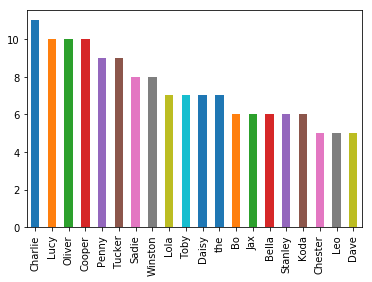

In [82]:
# 哪种名字比较受欢迎？
df_weratedog_complete[df_weratedog_complete['name'].notna()].name.value_counts().head(20).plot(kind='bar')

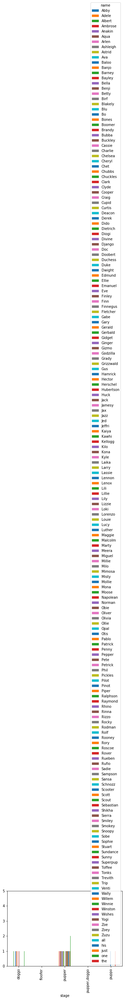

In [83]:
#不同种类狗起名字的偏好是什么？
#df_weratedog_complete.groupby(["name"]).stage.value_counts().unstack().plot(kind = 'bar')
# name & stage is not null
temp = df_weratedog_complete[(df_weratedog_complete['name'].notna()) & (df_weratedog_complete['stage'].notna())]

temp.groupby(["stage"]).name.value_counts().unstack().plot(ylim=(0,5),kind = 'bar')

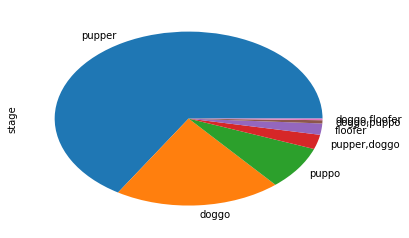

In [84]:
df_weratedog_complete.stage.value_counts().plot(kind='pie')

In [85]:
df_weratedog_complete[df_weratedog_complete.stage=='pupper'].name.value_counts()

Cooper       2
Milo         2
the          2
Pickles      2
one          2
Chuckles     2
Gus          2
Lennon       2
Birf         1
Phil         1
Kona         1
Penny        1
Larry        1
Lorenzo      1
Lillie       1
Raymond      1
Luther       1
Jed          1
Bella        1
Patrick      1
Bubba        1
Laika        1
Toffee       1
Fletcher     1
Eve          1
Zuzu         1
Bo           1
Trevith      1
Curtis       1
Dwight       1
Hector       1
Sansa        1
Jeffri       1
Jazz         1
Clark        1
Benji        1
Baloo        1
Sophie       1
Winston      1
Gidget       1
Smokey       1
Olivia       1
Banjo        1
Ava          1
Scott        1
Ashleigh     1
Jax          1
Zoe          1
Hubertson    1
Ollie        1
Grady        1
Clyde        1
Kawhi        1
Ambrose      1
Buckley      1
Gizmo        1
Gabe         1
Oliver       1
Gerbald      1
Sadie        1
Malcolm      1
Rueben       1
Mona         1
Finn         1
Norman       1
Pepper       1
Rory      

In [86]:
df_weratedog_complete[df_weratedog_complete.stage=='doggo'].name.value_counts()

Doobert     1
Pilot       1
his         1
Cassie      1
Rizzo       1
Emanuel     1
Loki        1
Barney      1
Divine      1
Kyle        1
Anakin      1
Sundance    1
Smiley      1
Rhino       1
Gerald      1
one         1
Piper       1
Finley      1
Yogi        1
Meera       1
Wishes      1
Miguel      1
Sobe        1
Rocky       1
Duchess     1
Lenox       1
Sampson     1
Cupid       1
Mimosa      1
Bo          1
Napolean    1
Pete        1
Deacon      1
Astrid      1
Scout       1
Sunny       1
Kellogg     1
Chubbs      1
Dietrich    1
Jack        1
Name: name, dtype: int64

In [87]:
df_weratedog_complete[df_weratedog_complete.stage=='puppo'].name.value_counts()


Lily         1
Kilo         1
Tonks        1
Abby         1
Duke         1
Snoopy       1
Bayley       1
Venti        1
Cooper       1
Lili         1
Lassie       1
Loki         1
Diogi        1
Shikha       1
Stuart       1
Betty        1
Lucy         1
Sebastian    1
Oliver       1
Pablo        1
Name: name, dtype: int64

In [88]:
df_weratedog_complete[df_weratedog_complete.stage=='floofer'].name.value_counts()

Doc          1
Moose        1
Grizzwald    1
Blu          1
Petrick      1
Name: name, dtype: int64

In [89]:
df_weratedog_complete.stage = df_weratedog_complete.stage.astype('category')

In [90]:
df_weratedog_complete.stage.dtypes

CategoricalDtype(categories=['doggo', 'doggo,floofer', 'doggo,puppo', 'floofer', 'pupper',
                  'pupper,doggo', 'puppo'],
                 ordered=False)

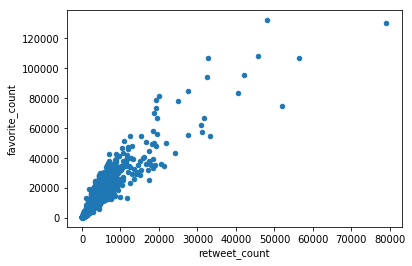

In [91]:
#高点赞代表高转发吗？
df_weratedog_complete.plot.scatter('retweet_count','favorite_count')

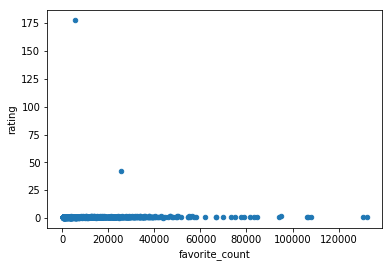

In [92]:
# 受大众喜欢的狗评价越高？
df_weratedog_complete.plot.scatter('favorite_count','rating')

# ---得出结论---

## 问题

1. 哪种名字比较受欢迎？
2. 不同种类狗起名字的偏好是什么？
3. 高点赞代表高转发吗？
4. 高点赞代表了专业好评吗？

## 答案

美国狗狗最常见的名为charile,Lucy,oliver,coopper等。名字大多情况下代表一个人性格和特质，但是通过分析狗种类与名字的关系，未发现特定种类的狗狗，出现一些使用频繁的名字。给狗命名无偏好体现。互联网时代点赞的成本非常低，远远低于转发的成本。研究和可视化发现点赞和转发的数据之前存在很强的线性关系，既点赞越多又转发越多。在宠物领域内，点赞和转发是成正比的。通过可视化研究发现，点赞和评分无实际关系，评分不会随着点赞数的增加而增加。

# Reference:

https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.read_json.html

https://stackoverflow.com/questions/48614158/read-json-file-as-pandas-dataframe

https://datascience.stackexchange.com/questions/33053/how-do-i-compare-columns-in-different-data-frames

https://cmdlinetips.com/2018/03/how-to-change-column-names-and-row-indexes-in-pandas/

https://stackoverflow.com/questions/34682828/extracting-specific-selected-columns-to-new-dataframe-as-a-copy

https://stackoverflow.com/questions/25351968/how-to-display-full-non-truncated-dataframe-information-in-html-when-convertin

https://www.geeksforgeeks.org/python-pandas-isnull-and-notnull/

https://pandas.pydata.org/pandas-docs/version/0.21/generated/pandas.DataFrame.drop.html

https://stackoverflow.com/questions/16327055/how-to-add-an-empty-column-to-a-dataframe

https://www.interviewqs.com/ddi_code_snippets/add_new_col_df_default_value

https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.to_timedelta.html#pandas.to_timedelta

https://campus.datacamp.com/courses/cleaning-data-in-python/cleaning-data-for-analysis?ex=10

https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.Series.str.extract.html

https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.Series.fillna.html

https://stackoverflow.com/questions/54343378/pandas-valueerror-pattern-contains-no-capture-groups

https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.Series.replace.html

https://stackoverflow.com/questions/21800169/python-pandas-get-index-of-rows-which-column-matches-certain-value

https://www.programiz.com/python-programming/methods/string/join

https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.to_csv.html

https://medium.com/@scottokinawa/exploratory-data-analysis-eda-with-pandas-684fa3262860

https://stackoverflow.com/questions/10880813/typeerror-sequence-item-0-expected-string-int-found